### Fracture processing for Tala

In [25]:
%load_ext autoreload
%autoreload 2

from fractureimport import PolyFracFile
import pprint
import numpy as np
import shapely.geometry as sg
import shapely.ops as so
from shapely import strtree
from matplotlib import pyplot as plt
import pandas as pd
import shapely

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [18]:
input_poly_file = "..\\..\\data\\measurements.poly"
fracs = PolyFracFile(input_poly_file)

In [59]:
orig_lns = fracs.original_lines
min_rect = orig_lns.minimum_rotated_rectangle
min_rect_coords = list(min_rect.exterior.coords)[:-1]

min_rect_pts = [{idx: sg.Point(min_rect_coords[idx])} for idx in range(len(min_rect_coords))]
min_rect_pts

[{0: <POINT (560425.693 6323620.893)>},
 {1: <POINT (560415.875 6323619.381)>},
 {2: <POINT (560570.048 6322618.447)>},
 {3: <POINT (560579.866 6322619.959)>}]

In [58]:
(shapely.hausdorff_distance(min_rect_pts[0], min_rect_pts[1:]))

[9.934209944534155, 1012.7374052772758, 1012.7859822010629]

In [19]:
# All individual fracture lines, after reprojection to the local grid
fracs.reprojected_lines

In [20]:
print(fracs.original_extent)
print(fracs.rotated_extent)
print(fracs.translated_extent)

(560418.7286002, 6322619.3938, 560576.3859869, 6323620.308894)
[560345.2846762337, 6322637.195719286, 560651.5478518673, 6323602.960743681]
(0.0, 0.0, 306.26317563361954, 965.7650243947282)


In [5]:
# search_tree = strtree.STRtree(fracs.reprojected_lines.geoms)

In [6]:
window_min_x = 10
window_max_x = 20

active_lines = fracs.search_fractures_x_window(window_min_x, window_max_x)


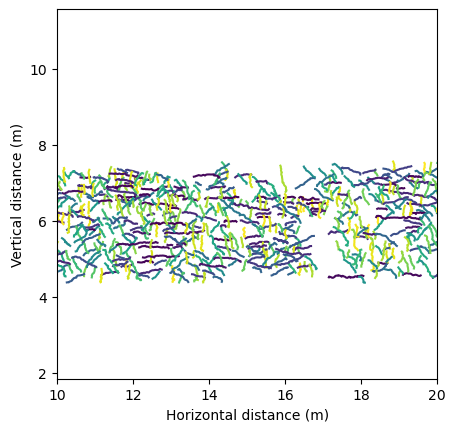

In [7]:
window_min_x = 10
window_max_x = 20

line_list = fracs.reprojected_lines

fig, ax = plt.subplots()
# fig.figure(figsize=(8,3), dpi=300) # change figure size and resolution

frac_dict = {}

for i in range(len(line_list.geoms)):
    # retrieve coordinates for line
    ln_coords = np.array(line_list.geoms[i].coords)
    i_arr = ln_coords[:, 0]
    k_arr = ln_coords[:, 2]
    
    dip_ij = fracs.dip_from_ij_arr(i_arr, k_arr)
    dip_rgba = fracs.rgba_col_val(
        dip_ij, cmap_name="viridis", scale_min=0.0, scale_max=90.0
    )

    if i_arr[0] < i_arr[-1] and k_arr[0] < k_arr[-1]:
        dip_dir = "N"
    elif i_arr[0] < i_arr[-1] and k_arr[0] > k_arr[-1]:
        dip_dir = "S"
    elif i_arr[0] > i_arr[-1] and k_arr[0] < k_arr[-1]:
        dip_dir = "S"
    elif i_arr[0] > i_arr[-1] and k_arr[0] > k_arr[-1]:
        dip_dir = "N"
    else:
        dip_dir="-"

    fraclength = fracs.reprojected_lines.geoms[i].length
    fracbounds = fracs.reprojected_lines.geoms[i].bounds
    fraccentroid = fracs.reprojected_lines.geoms[i].centroid

    frac_dict[i] = {
        "length": fraclength,
        "dip": dip_ij,
        "dip_dir": dip_dir,
        # "centroid": fraccentroid,
        "mid_x_coord": fraccentroid.xy[0][0],
        "mid_y_coord": fraccentroid.xy[1][0],
    }

    ax.plot(i_arr, k_arr, color=dip_rgba)

#     for i in range(len(i_arr)):
#         string_out += str(i_arr[i]) + "\t" + str(j_arr[i]) + "\t"
#         # print(i, len(i_arr))
#         if i == len(i_arr) - 1:
#             # print(i)
#             string_out += "\n"
#             # list_string_lines_out.append(string_line_out)
# # write to output file
# with open(out_path, "w") as f_out:
#     f_out.write(string_out)

ax.set_xlim(window_min_x, window_max_x)
ax.set_ylabel("Vertical distance (m)")
ax.set_xlabel("Horizontal distance (m)")
ax.set_aspect("equal")

# fig.savefig(out_fig_name)
plt.show()

In [8]:
pd.DataFrame().from_dict(frac_dict, orient='index').to_csv("./test.csv", sep=',', index=True, index_label="index")